In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from PyAstronomy import pyasl
from sklearn.metrics import mean_squared_error
from scipy.signal import savgol_filter
from sklearn import preprocessing, svm
from sklearn.model_selection import cross_validate
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
%matplotlib notebook


df0=pd.read_csv(r'D:\UserData\z0041t8e\Documents\Projects\3_TICO2\Compiled_Data\dataset0_smoothed.csv', sep=',',  index_col=0)
df1=pd.read_csv(r'D:\UserData\z0041t8e\Documents\Projects\3_TICO2\Compiled_Data\dataset1_smoothed.csv', sep=',',  index_col=0)
df2=pd.read_csv(r'D:\UserData\z0041t8e\Documents\Projects\3_TICO2\Compiled_Data\dataset2_smoothed.csv', sep=',',  index_col=0)
df3=pd.read_csv(r'D:\UserData\z0041t8e\Documents\Projects\3_TICO2\Compiled_Data\dataset3_smoothed.csv', sep=',',  index_col=0)

dataset_df = pd.concat([df0, df1, df2, df3])

In [24]:
dataset_df.shape

(107569, 287)

In [23]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt

# Import plotly package
import plotly
import plotly.graph_objs as go

# Check ploltly version
plotly.__version__

# To communicate with Plotly's server, sign in with credentials file
import chart_studio.plotly as py
py.sign_in('mohamed-soliman', '3zuAUecgs31Phjfm204X')

In [25]:
total_features_df = dataset_df.drop(['File_No', 'Cast_date', 'dayOfWeek', 'Die', 'cav1_defect','cav2_defect', 'defect_smoothed', 'Shot_no','Shift', 'Part'], axis=1)

features_df = total_features_df.drop(['defect'], axis=1)
features_df = pd.get_dummies(features_df)
labels_df = dataset_df.loc[:, ['defect']]



In [26]:
# PCA
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaled_features = scaler.fit_transform(features_df)
print(scaled_features.shape)
scaled_features

(107569, 276)


array([[ 2.87419747e-01, -1.98440466e+00, -1.76543172e-01, ...,
         4.98164926e-01, -2.66214095e-01, -1.07216525e+00],
       [ 4.64678260e-01, -1.89096317e+00, -1.77172194e-01, ...,
         5.47074827e-01, -2.60515505e-01, -1.00185960e+00],
       [ 6.03387758e-01, -1.81609648e+00, -1.77169156e-01, ...,
         5.82942095e-01, -2.53928937e-01, -8.78399940e-01],
       ...,
       [ 8.89077008e-02,  5.38025683e-01, -8.71522583e-03, ...,
        -7.05067559e-01,  2.54380469e-03,  5.84758406e-01],
       [ 1.00768432e-01,  5.19338765e-01, -3.21934399e-02, ...,
        -5.98916860e-01,  1.34228704e-03, -5.99978733e-02],
       [-3.32275756e+00,  1.61794065e-01,  6.67315799e+00, ...,
        -4.20408668e-01,  2.34764705e-01,  2.34827849e-01]])

Total variance captured: 36.46%


<IPython.core.display.Javascript object>


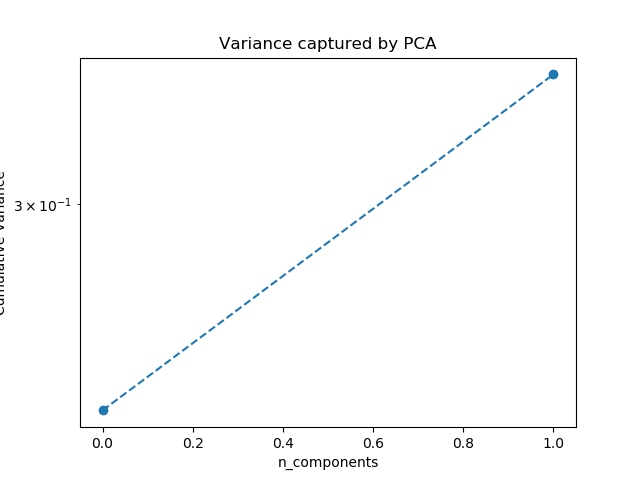

In [44]:
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
trans_features = pca.fit_transform(scaled_features)

print('Total variance captured: {:.2f}%'.format(pca.explained_variance_ratio_.cumsum()[-1]*100))
plt.figure(20)
plt.semilogy(pca.explained_variance_ratio_.cumsum(), '--o')
plt.title('Variance captured by PCA')
plt.xlabel('n_components')
plt.ylabel('Cumulative Variance')
#core3_headPress_trans = pca_core3_headPress.fit_transform(core3_headPress_scaled)
#plt.semilogy(pca_core3_headPress.explained_variance_ratio_.cumsum(), '--o')




trans_features_df = pd.DataFrame(data=trans_features, 
                                       columns=['PCA {}'.format(i+1) for i in range(trans_features.shape[1])])


In [6]:
trans_features_df.shape

(107569, 30)

In [6]:
df = trans_features_df
df['defect'] = labels_df.defect.values
trans_features_vis = df #signal.resample(df, 10000)

sub_df0 = trans_features_vis[trans_features_vis['defect'] == 0]
sub_df1 = trans_features_vis[trans_features_vis['defect'] == 1]

DSF = len(trans_features_vis)//25000
sub_df0 = signal.resample(sub_df0, len(sub_df0)//DSF)
sub_df1 = signal.resample(sub_df1, len(sub_df1)//DSF)

C:\Users\z0041t8e\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\signal\signaltools.py:2223: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.

C:\Users\z0041t8e\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\signal\signaltools.py:2225: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.



In [143]:
len(sub_df1)

651

C:\Users\z0041t8e\AppData\Local\Continuum\anaconda3\lib\site-packages\plotly\graph_objs\_deprecations.py:494: DeprecationWarning:

plotly.graph_objs.Scene is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.Scene




(-28.706958282369005,
 33.02726137279825,
 -21.084495734860354,
 23.179367570360522)

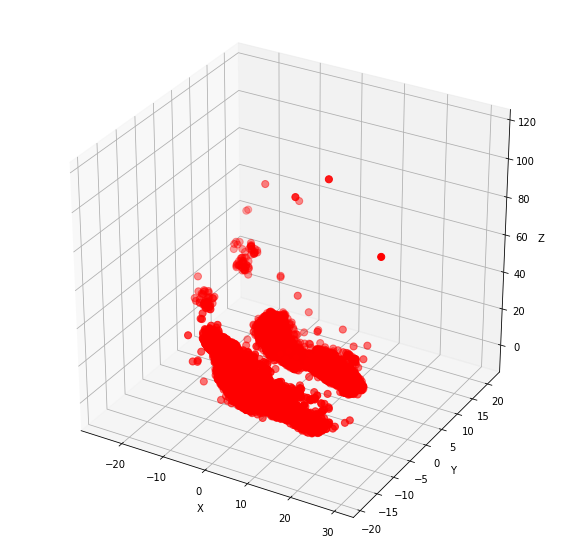

In [7]:


scatter0 = go.Scatter3d(
    mode = "markers",
    #name = "y",
    #type = "scatter3d",
    x = sub_df0[:,0],
    y = sub_df0[:,1],
    z = sub_df0[:,2],
    marker=dict(size=4, color='blue', line=dict(color='black', width=0.5), opacity=0.8)
)
scatter1 = go.Scatter3d(
    mode = "markers",
    #name = "y",
    #type = "scatter3d",
    x = sub_df1[:,0],
    y = sub_df1[:,1],
    z = sub_df1[:,2],
    marker=dict(size=4, color='red', line=dict(color='black', width=0.5), opacity=0.8)
)
#clusters = dict(
#    alphahull = 7,
#    name = "y",
#    opacity = 0.1,
#    type = "mesh3d",
#    x = df['x'], y = df['y'], z = df['z']
#)

# Dictionary of style options for all axes
axis = dict(
    showbackground=True, # show axis background
    backgroundcolor="rgb(204, 204, 204)", # set background color to grey
    gridcolor="rgb(255, 255, 255)",       # set grid line color
    zerolinecolor="rgb(255, 255, 255)",   # set zero grid line color
)




layout = go.Layout(
    title='1st-order (linear) plane', # set plot title
    scene=go.Scene(  # axes are part of a 'scene' in 3d plots
         xaxis = dict( zeroline=False ),
        yaxis = dict( zeroline=False ),
        zaxis = dict( zeroline=False ),  # set z-axis style
))

# Make a figure object
#data_test1 = go.Data([scatter0, scatter1])

fig = go.Figure(data=[scatter0, scatter1], layout=layout)

# Send to Plotly and show in notebook
#py.iplot(fig, filename='1st-order (linear) plane')
#plt.show(fig)


# regular grid covering the domain of the data
#mn = np.min(trans_features_df, axis=0)
#mx = np.max(trans_features_df, axis=0)
#X,Y = np.meshgrid(np.linspace(mn[0], mx[0], 20), np.linspace(mn[1], mx[1], 20))
#XX = X.flatten()
#YY = Y.flatten()
    
# best-fit linear plane (1st-order)
#A = np.c_[data[:,0], data[:,1], np.ones(data.shape[0])]
#C,_,_,_ = scipy.linalg.lstsq(A, data[:,2])    # coefficients
    
# evaluate it on grid
#Z = C[0]*X + C[1]*Y + C[2]
    
fig1 =  plt.figure(figsize=(10, 10))
ax = fig1.gca(projection='3d')
#ax.plot_surface(X, Y, Z, rstride=1, cstride=1, alpha=0.2)
ax.scatter(trans_features_df['PCA 1'],trans_features_df['PCA 2'],trans_features_df['PCA 3'], c='r', s=50)
plt.xlabel('X')
plt.ylabel('Y')
ax.set_zlabel('Z')
ax.axis('equal')
ax.axis('tight')

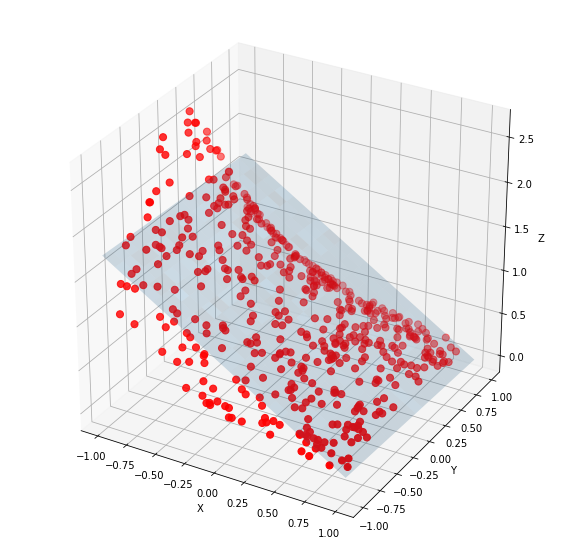

In [43]:
import numpy as np
import scipy.linalg
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt

# Import plotly package
import plotly
import plotly.graph_objs as go

# Check ploltly version
plotly.__version__

# To communicate with Plotly's server, sign in with credentials file
import chart_studio.plotly as py



# Create data with x and y random over [-2, 2], and z a Gaussian function of x and y.
np.random.seed(12345)
x = 2 * (np.random.random(500) - 0.5)
y = 2 * (np.random.random(500) - 0.5)

def f(x, y):
    return np.exp(-(x + y ** 2))

z = f(x, y)

data = np.c_[x,y,z]

# regular grid covering the domain of the data
mn = np.min(data, axis=0)
mx = np.max(data, axis=0)
X,Y = np.meshgrid(np.linspace(mn[0], mx[0], 20), np.linspace(mn[1], mx[1], 20))
XX = X.flatten()
YY = Y.flatten()
    
# best-fit linear plane (1st-order)
A = np.c_[data[:,0], data[:,1], np.ones(data.shape[0])]
C,_,_,_ = scipy.linalg.lstsq(A, data[:,2])    # coefficients
    
# evaluate it on grid
Z = C[0]*X + C[1]*Y + C[2]
    
# or expressed using matrix/vector product
#Z = np.dot(np.c_[XX, YY, np.ones(XX.shape)], C).reshape(X.shape)










# plot points and fitted surface using Matplotlib
fig1 =  plt.figure(figsize=(10, 10))
ax = fig1.gca(projection='3d')
ax.plot_surface(X, Y, Z, rstride=1, cstride=1, alpha=0.2)
ax.scatter(data[:,0], data[:,1], data[:,2], c='r', s=50)
plt.xlabel('X')
plt.ylabel('Y')
ax.set_zlabel('Z')
ax.axis('equal')
ax.axis('tight')

# plot points and fitted surface using Plotly
trace1 = go.Scatter3d(
    x=data[:,0],
    y=data[:,1],
    z=data[:,2],
    mode='markers',
    marker=dict(size=4, color='red', line=dict(color='black', width=0.5), opacity=0.8)
)

trace2 = go.Surface(z=Z, x=X, y=Y, colorscale='RdBu', opacity=0.999)

# Package the trace dictionary into a data object
data_test1 = go.Data([trace1, trace2])

# Dictionary of style options for all axes
axis = dict(
    showbackground=True, # show axis background
    backgroundcolor="rgb(204, 204, 204)", # set background color to grey
    gridcolor="rgb(255, 255, 255)",       # set grid line color
    zerolinecolor="rgb(255, 255, 255)",   # set zero grid line color
)

# Make a layout object
layout = go.Layout(
    title='1st-order (linear) plane', # set plot title
    scene=go.Scene(  # axes are part of a 'scene' in 3d plots
        xaxis=dict( zeroline=False ), # set x-axis style
        yaxis=dict( zeroline=False ), # set y-axis style
        zaxis=dict( zeroline=False )),  # set z-axis style
)

# Make a figure object
fig0 = go.Figure(data=data_test1, layout=layout)

# Send to Plotly and show in notebook
#py.iplot(fig, filename='test1')

In [9]:
fig

In [50]:
fig0

            PCA 1      PCA 2      PCA 3
0       10.340956 -17.558701  35.608829
1       11.716846 -17.599518  30.691708
2       12.829349 -17.892646  30.073363
3        8.791946   2.792823   8.212006
4       10.994496   2.616954   3.555286
5        8.168972   3.636570   4.685156
6        8.429724   3.414224   4.324184
7       11.087069   2.598867   2.690079
8        8.682909   2.966848   3.779182
9        7.538941   3.969821   3.660061
10       7.126010   4.162268   4.025005
11      10.139304   3.363178   2.116742
12       8.375508   3.389580   3.420686
13      11.092557   2.874412   2.439918
14       7.607080   4.099535   4.129450
15       7.711908   4.011141   3.552961
16       7.411504   3.973712   3.016485
17       9.973886   3.402679   2.261837
18       9.894416   3.256119   2.433446
19       7.541032   4.001964   3.457884
20       7.499084   4.001123   3.371014
21       9.747233   3.133906   2.406069
22       7.899170   3.509683   3.061720
23       9.079133   3.846107   1.730846


<IPython.core.display.Javascript object>


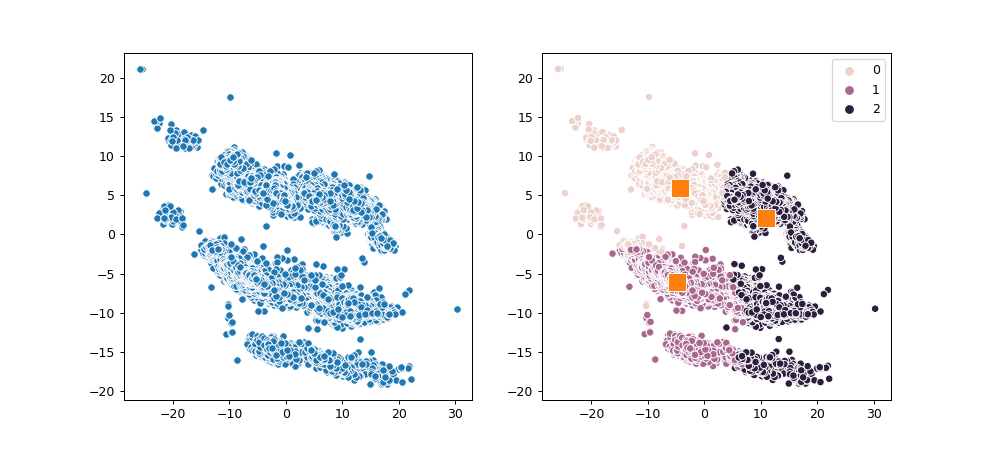

[-4.40172238 -4.90800022 10.88475348] [ 5.98121927 -6.01154085  2.12644531]


In [10]:
from fcmeans import FCM
from sklearn.datasets import make_blobs
from matplotlib import pyplot as plt
from seaborn import scatterplot as scatter

# fit the fuzzy-c-means
fcm = FCM(n_clusters=3)
fcm.fit(trans_features)

# outputs
fcm_centers = fcm.centers
fcm_labels  = fcm.u.argmax(axis=1)

print((trans_features_df))
#print(fcm_labels,fcm_centers)
# plot result
f, axes = plt.subplots(1, 2, figsize=(11,5))
scatter(trans_features[:,0], trans_features[:,1], ax=axes[0])
scatter(trans_features[:,0], trans_features[:,1], ax=axes[1], hue=fcm_labels)
scatter(fcm_centers[:,0], fcm_centers[:,1], ax=axes[1],marker="s",s=200)
#scatter(fcm_centers[:,0], fcm_centers[:,2], ax=axes[1],marker="s",s=200)
#scatter(fcm_centers[:,1], fcm_centers[:,2], ax=axes[1],marker="s",s=200)
plt.show()
print(fcm_centers[:,0], fcm_centers[:,1])

<IPython.core.display.Javascript object>


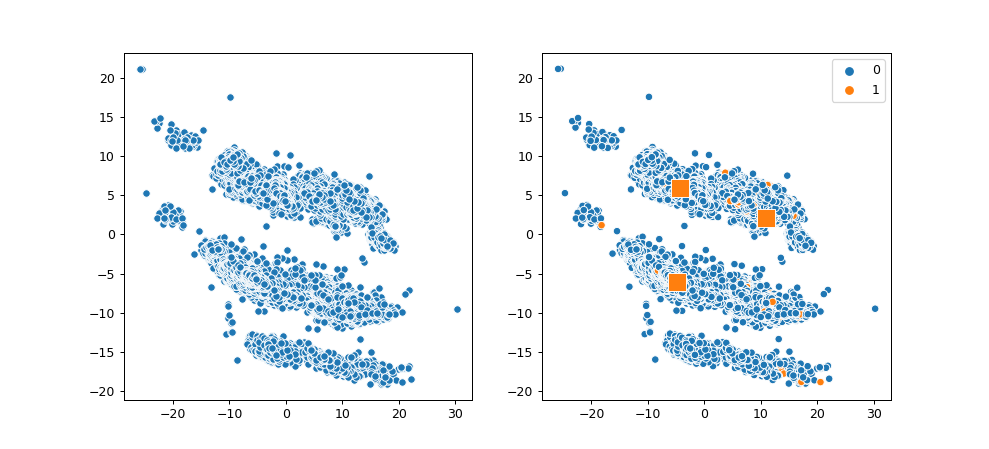

In [61]:
ranking = np.random.normal(size=0)

f, axes = plt.subplots(1, 2, figsize=(11,5))
scatter(trans_features[:,0], trans_features[:,1], ax=axes[0])
scatter(trans_features[:,0], trans_features[:,1], ax=axes[1], hue=labels_df.values.ravel())
scatter(fcm_centers[:,0], fcm_centers[:,1], ax=axes[1],marker="s",s=200)
plt.show()

(107569,)

In [56]:
np.array(a,  dtype='int64').ravel()

(107569,)

In [52]:
fcm_labels.shape

(107569,)

In [76]:
fig

In [79]:
fig

In [8]:
fig

In [ ]:
correct = 0
for i in range(len(X)):
    predict_me = np.array(X[i].astype(float))
    predict_me = predict_me.reshape(-1, len(predict_me))
    prediction = clf.predict(predict_me)
    if prediction[0] == y[i]:
        correct += 1

print(correct/len(X))

In [135]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import linalg

from sklearn.decomposition import PCA, FactorAnalysis
from sklearn.covariance import ShrunkCovariance, LedoitWolf
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV

n_components = np.arange(0, 150, 10)  # options for n_components

X = scaled_features

def compute_scores(X):
    pca = PCA(svd_solver='full')
    fa = FactorAnalysis()

    pca_scores, fa_scores = [], []
    for n in n_components:
        pca.n_components = n
        fa.n_components = n
        pca_scores.append(np.mean(cross_val_score(pca, X, cv=5)))
        fa_scores.append(np.mean(cross_val_score(fa, X, cv=5)))

    return pca_scores, fa_scores


def shrunk_cov_score(X):
    shrinkages = np.logspace(-2, 0, 30)
    cv = GridSearchCV(ShrunkCovariance(), {'shrinkage': shrinkages}, cv=5)
    return np.mean(cross_val_score(cv.fit(X).best_estimator_, X, cv=5))


def lw_score(X):
    return np.mean(cross_val_score(LedoitWolf(), X, cv=5))



pca_scores, fa_scores = compute_scores(X)
n_components_pca = n_components[np.argmax(pca_scores)]
n_components_fa = n_components[np.argmax(fa_scores)]

pca = PCA(svd_solver='full', n_components='mle')
pca.fit(X)
n_components_pca_mle = pca.n_components_

print("best n_components by PCA CV = %d" % n_components_pca)
print("best n_components by FactorAnalysis CV = %d" % n_components_fa)
print("best n_components by PCA MLE = %d" % n_components_pca_mle)

plt.figure()
plt.plot(n_components, pca_scores, 'b', label='PCA scores')
plt.plot(n_components, fa_scores, 'r', label='FA scores')
plt.axvline(rank, color='g', label='TRUTH: %d' % rank, linestyle='-')
plt.axvline(n_components_pca, color='b',
            label='PCA CV: %d' % n_components_pca, linestyle='--')
plt.axvline(n_components_fa, color='r',
            label='FactorAnalysis CV: %d' % n_components_fa,
            linestyle='--')
plt.axvline(n_components_pca_mle, color='k',
            label='PCA MLE: %d' % n_components_pca_mle, linestyle='--')

# compare with other covariance estimators
plt.axhline(shrunk_cov_score(X), color='violet',
            label='Shrunk Covariance MLE', linestyle='-.')
plt.axhline(lw_score(X), color='orange',
            label='LedoitWolf MLE' % n_components_pca_mle, linestyle='-.')

plt.xlabel('nb of components')
plt.ylabel('CV scores')
plt.legend(loc='lower right')
plt.title(title)

plt.show()


best n_components by PCA CV = 30
best n_components by FactorAnalysis CV = 0
best n_components by PCA MLE = 281


<IPython.core.display.Javascript object>

NameError: name 'rank' is not defined

<IPython.core.display.Javascript object>


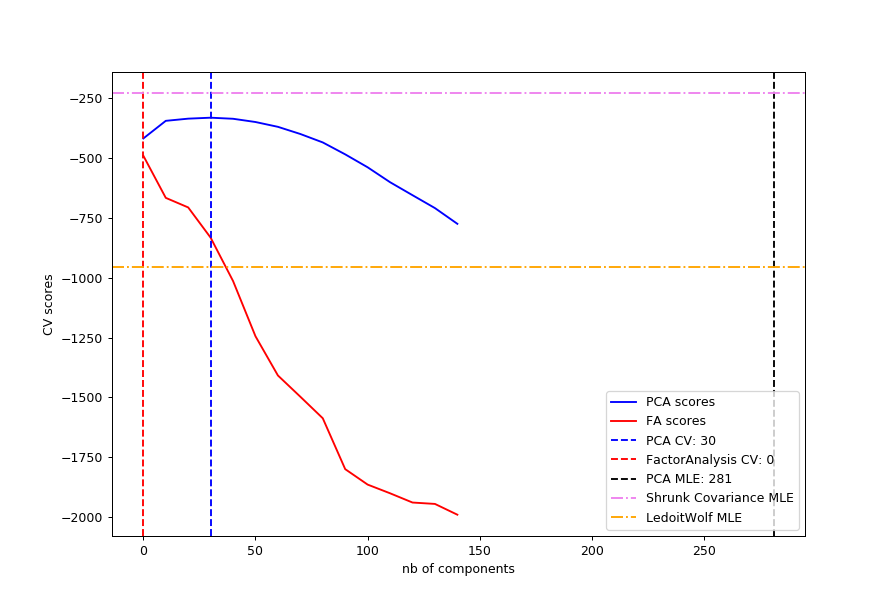

In [139]:
plt.figure()
plt.plot(n_components, pca_scores, 'b', label='PCA scores')
plt.plot(n_components, fa_scores, 'r', label='FA scores')
#plt.axvline(rank, color='g', label='TRUTH: %d' % rank, linestyle='-')
plt.axvline(n_components_pca, color='b',
            label='PCA CV: %d' % n_components_pca, linestyle='--')
plt.axvline(n_components_fa, color='r',
            label='FactorAnalysis CV: %d' % n_components_fa,
            linestyle='--')
plt.axvline(n_components_pca_mle, color='k',
            label='PCA MLE: %d' % n_components_pca_mle, linestyle='--')

# compare with other covariance estimators
plt.axhline(shrunk_cov_score(X), color='violet',
            label='Shrunk Covariance MLE', linestyle='-.')
plt.axhline(lw_score(X), color='orange',
            label='LedoitWolf MLE' % n_components_pca_mle, linestyle='-.')

plt.xlabel('nb of components')
plt.ylabel('CV scores')
plt.legend(loc='lower right')
#plt.title('Heteroscedastic Noise')

plt.show()




In [10]:
from sklearn.cluster import MeanShift, KMeans

msc = MeanShift()
msc.fit(trans_features)

MeanShift(bandwidth=None, bin_seeding=False, cluster_all=True, min_bin_freq=1,
     n_jobs=None, seeds=None)

In [9]:
trans_features.shape

(107569, 30)

In [11]:
labels = msc.labels_
cluster_centers = msc.cluster_centers_

In [24]:
np.unique(labels).shape

(238,)

In [15]:
labels.shape

(107569,)

In [28]:
np.savetxt("clusters_Centers_by_meanshift.csv", cluster_centers, delimiter=",")

In [7]:
from numpy import genfromtxt
my_data = genfromtxt('clusters_by_meanshift.csv', delimiter=',')

In [8]:
np.unique(my_data).shape

(238,)

In [9]:
dataset_df['cluster_group']= my_data

#for i in range(len(trans_features_df)):
 #   trans_features_df['cluster_group'].iloc[i] = labels[i]

In [10]:
dataset_df.head()

,File_No,fDie1wflow_en0,fDie1wflow_en1,fDie1wflow_en2,fDie1wflow_en3,fDie1wflow_en4,fDie1wflow_mse,fDie1wflow_mae,fDie2wflow_en0,fDie2wflow_en1,...,Die,Cast_date,Shift,Shot_no,dayOfWeek,cav1_defect,cav2_defect,defect,defect_smoothed,cluster_group
0,B1012-278-1AF10005,21.692999,0.759790,-0.968287,13.580341,-0.567633,0.002722,0.038137,9.908647,1.283877,...,1,2018-01-15,1,5,0,0,0,0,0.0,1.0
1,B1012-278-1AF10006,22.802261,1.165540,-0.969839,15.000215,-0.767543,0.002549,0.035166,9.719274,1.268317,...,1,2018-01-15,1,6,0,0,0,0,0.0,1.0
2,B1012-278-1AF10007,23.670288,1.490633,-0.969832,15.979490,-0.831797,0.002225,0.031885,9.586231,0.992506,...,1,2018-01-15,1,7,0,0,0,0,0.0,1.0
3,B1012-278-1AF10008,23.920792,2.118496,-0.968945,15.828067,-0.853646,0.001940,0.026800,9.413850,0.393041,...,1,2018-01-15,1,8,0,0,0,0,0.0,0.0
4,B1012-278-1AF10009,24.256344,2.081036,-0.970541,16.486008,-0.890179,0.001000,0.020291,9.127824,0.392960,...,1,2018-01-15,1,9,0,0,0,0,0.0,0.0


In [13]:
n_clusters_ = len(np.unique(my_data))
cluster_sizes = [0 for x in range(n_clusters_)]
for i in range(n_clusters_):
    temp_df = dataset_df[ (dataset_df['cluster_group']==float(i)) ]
    cluster_sizes[i] = len(temp_df)
    
print(cluster_sizes)

[103816, 1491, 87, 121, 69, 66, 64, 44, 43, 36, 42, 16, 18, 25, 28, 19, 108, 17, 233, 12, 12, 10, 9, 15, 11, 7, 7, 9, 161, 5, 8, 5, 5, 16, 4, 5, 4, 4, 4, 3, 5, 4, 41, 3, 3, 3, 3, 3, 3, 4, 3, 5, 2, 5, 26, 5, 2, 2, 5, 3, 2, 2, 46, 2, 2, 7, 2, 2, 2, 2, 4, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 16, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 491, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 1, 1, 1, 1, 1, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 7, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 5, 1, 1, 1, 1, 1, 7, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 5, 1, 1, 2, 1, 5, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]


In [14]:
n_clusters_ = len(np.unique(my_data))
defect_rates = [0 for x in range(n_clusters_)]
for i in range(n_clusters_):
    temp_df = dataset_df[ (dataset_df['cluster_group']==float(i)) ]
    defect_cluster = temp_df[  (temp_df['defect'] == 1) ]
    defect_rate = len(defect_cluster) / len(temp_df)
    defect_rates[i] = float("{:.2f}".format(defect_rate*100))  
    
print(defect_rates)

[2.46, 1.34, 1.15, 0.83, 1.45, 0.0, 0.0, 2.27, 2.33, 0.0, 4.76, 6.25, 0.0, 0.0, 0.0, 5.26, 1.85, 0.0, 0.86, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 3.73, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 20.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 2.44, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 3.85, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 50.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 100.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 6.25, 0.0, 0.0, 0.0, 0.0, 0.0, 100.0, 0.0, 0.0, 0.0, 0.0, 1.22, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 33.33, 0.0, 0.0, 0.0, 0.0, 0.0, 100.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

In [18]:
cluster_1 = dataset_df[ (dataset_df['cluster_group']==0) ]
len(cluster_1[  (cluster_1['defect'] == 1) ])

2550

In [19]:
len(dataset_df[  (dataset_df['defect'] == 1) ])

2605

In [56]:
H, edges = np.histogramdd(np.array(trans_features.tolist()), density= True)

In [52]:
H, xedges, yedges = np.histogram2d(trans_features[:,0],trans_features[:,1], density = True )

<IPython.core.display.Javascript object>


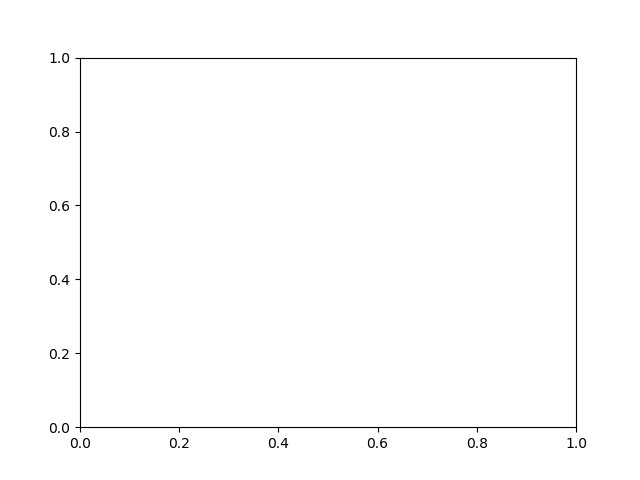

ValueError: x and y must have same first dimension, but have shapes (10, 10) and (107569,)

In [53]:
plt.figure(30)
plt.plot(H, dataset_df['defect'])
plt.show

In [35]:
edges

[array([-26.07517058, -20.44710149, -14.81903239,  -9.19096329,
         -3.5628942 ,   2.0651749 ,   7.693244  ,  13.32131309,
         18.94938219,  24.57745129,  30.20552039]),
 array([-19.4823096 , -15.47017304, -11.45803648,  -7.44589992,
         -3.43376336,   0.5783732 ,   4.59050976,   8.60264632,
         12.61478288,  16.62691944,  20.639056  ]),
 array([ -6.25498963,   6.00241632,  18.25982228,  30.51722823,
         42.77463419,  55.03204014,  67.2894461 ,  79.54685205,
         91.80425801, 104.06166396, 116.31906992])]

In [48]:
trans_features[:,0].shape

IndexError: index 2 is out of bounds for axis 1 with size 2

In [57]:
H.shape

(10, 10)

In [55]:
trans_features.tolist()

[[10.323606320493607, -18.329545896912663],
 [11.706244484032748, -18.30551915345484],
 [12.824335018723238, -18.592412972684922],
 [8.678852946507888, 2.6626601936230996],
 [10.893334646569519, 2.555273915431864],
 [8.051909621666224, 3.5609637050619805],
 [8.315824754901568, 3.3404571911335315],
 [10.987139872408813, 2.5472481058645813],
 [8.572503463177249, 2.8947353979589137],
 [7.419185342513305, 3.907536485338235],
 [7.003910482253412, 4.096065346102231],
 [10.032262515910514, 3.327208638311643],
 [8.262145418091793, 3.327086229020373],
 [10.991431406124821, 2.8345392528111955],
 [7.486287271293575, 4.035484273498257],
 [7.592711352612215, 3.9536146463958692],
 [7.290858564879967, 3.9168912517177903],
 [9.86582663883566, 3.3630431671696344],
 [9.786455848607174, 3.2122660925282727],
 [7.421268696082767, 3.943541157821725],
 [7.379223488316587, 3.9446414449073206],
 [9.63833779125978, 3.088980490464478],
 [7.78393269666908, 3.4514988915831677],
 [8.966552120816631, 3.8142443598414